In [1]:
import warnings
import scanpy as sc
import squidpy as sq
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from urllib import request
import scanorama
import json
import os

sc.settings.set_figure_params(dpi=80)
#sc.set_figure_params(facecolor="white", figsize=(8, 8))
warnings.simplefilter(action='ignore', category=FutureWarning)
sc.settings.verbosity = 3

# Глобальное окружение

## Подгрузим данные

In [4]:
os.listdir('../data/anndata_objects/spatial_libd_human')

['151507.h5ad',
 '151508.h5ad',
 '151509.h5ad',
 '151510.h5ad',
 '151669.h5ad',
 '151670.h5ad',
 '151671.h5ad',
 '151672.h5ad',
 '151673.h5ad',
 '151674.h5ad',
 '151675.h5ad',
 '151676.h5ad',
 'spatial_libd_human.h5ad']

In [5]:
adata = sc.read_h5ad('../data/anndata_objects/spatial_libd_human/spatial_libd_human.h5ad')
adata.obs_names_make_unique()
adata

C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 47681 × 33538
    obs: 'in_tissue', 'array_row', 'array_col', 'label', 'sample_id'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

Посмотрим есть ли неразмеченые споты

In [6]:
adata.obs.label.isna().value_counts()

False    47329
True       352
Name: label, dtype: int64

In [7]:
adata.obs.label.value_counts()

L3    17587
L5     7300
L6     6201
L1     5322
WM     4514
L4     3547
L2     2858
Name: label, dtype: int64

In [8]:
samples = list(adata.uns['spatial'].keys())

## Посмотрим на изображения

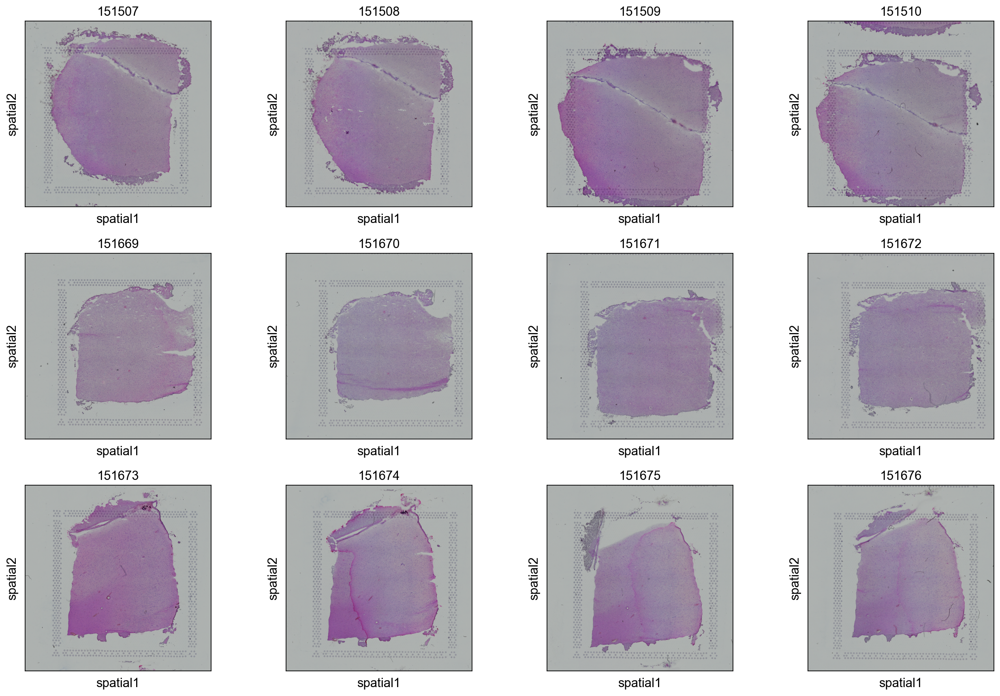

In [15]:
sq.pl.spatial_scatter(adata, library_key='sample_id', title=samples, ncols=4)

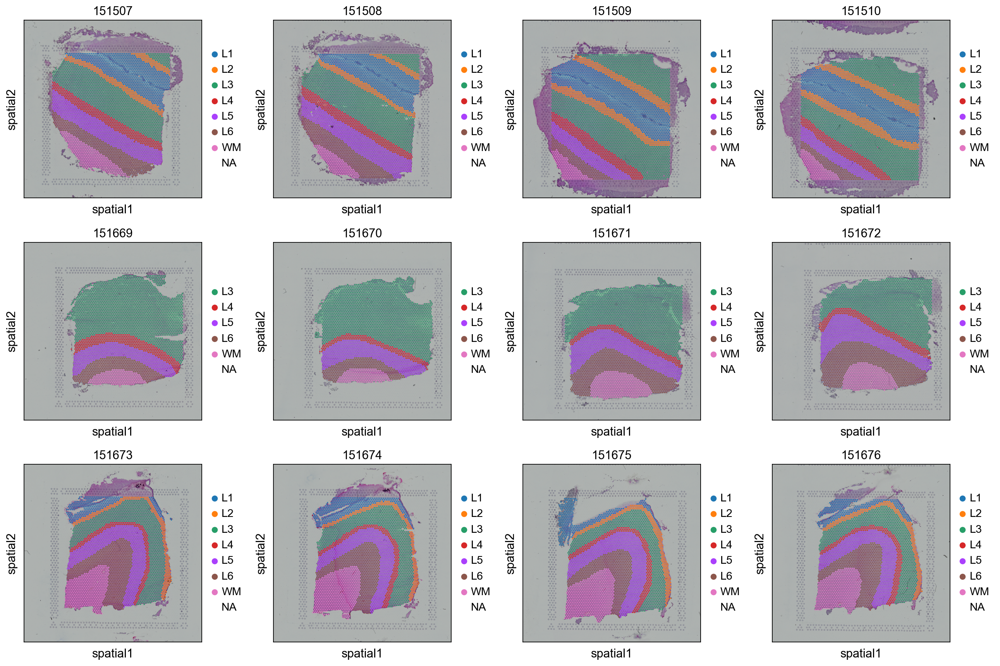

In [14]:
sq.pl.spatial_scatter(adata, color=['label'], library_key='sample_id', ncols=4, title=samples)

## Посмотрим на метрики

In [11]:
# add info on mitochondrial and hemoglobin genes to the objects.
adata.var['mt'] = adata.var_names.str.startswith('MT-')
adata.var['hb'] = adata.var_names.str.contains(("^HB[AB]"))
adata.var['ribo'] = adata.var_names.str.contains(("^RP[LS]"))

sc.pp.calculate_qc_metrics(
    adata, qc_vars=['mt','hb','ribo'],
    percent_top=None, log1p=False, inplace=True)

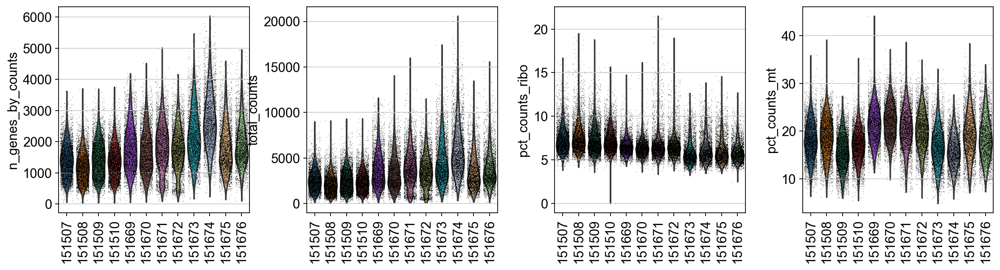

In [18]:
sc.pl.violin(adata,
             keys = ['n_genes_by_counts', 'total_counts','pct_counts_ribo', 'pct_counts_mt'],
             jitter=0.4, groupby = 'sample_id', rotation= 90, size=0.5)

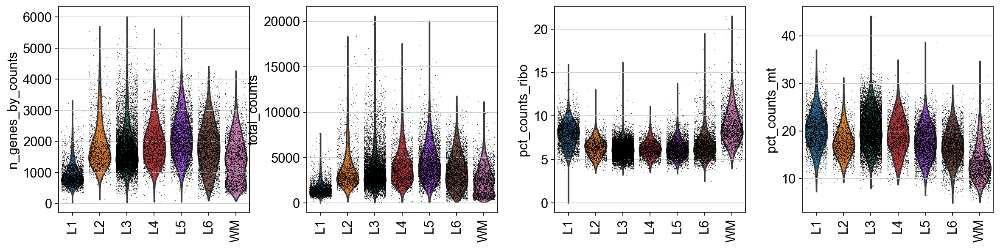

In [19]:
sc.pl.violin(adata,
             keys = ['n_genes_by_counts', 'total_counts','pct_counts_ribo', 'pct_counts_mt'],
             jitter=0.4, groupby = 'label', rotation= 90, size=0.5)

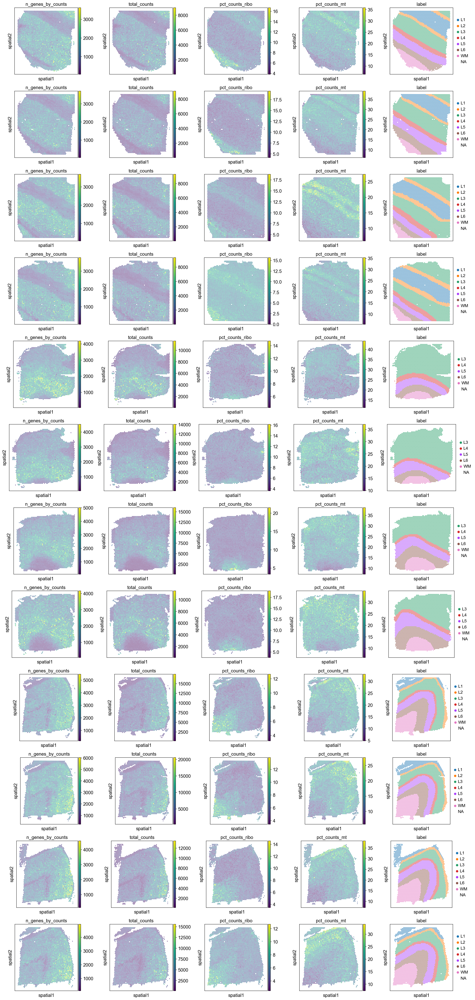

In [23]:
sq.pl.spatial_scatter(adata,
                      color=['n_genes_by_counts', 'total_counts','pct_counts_ribo', 'pct_counts_mt', 'label'],
                      library_key='sample_id', ncols=5, img=False)

## PCA

In [21]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.tl.pca(adata)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:02:37)


C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\aleks\anaconda3\envs\scanorama39\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


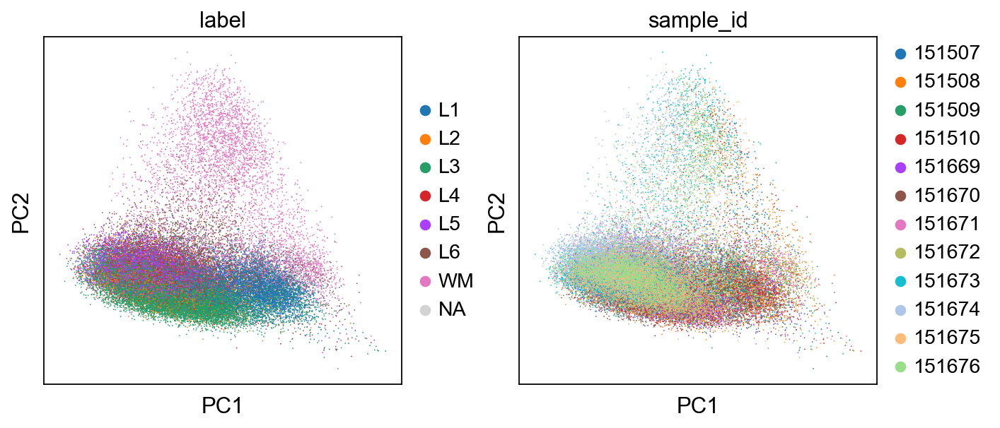

In [22]:
sc.pl.pca(adata, 
          color=['label', 'sample_id'],
          ncols=2, show=True)